### Задание № 9


#### Тема: Автокодировщики

### Задание Ultra Lite

Перепишите автокодировщик Mnist “с нуля”  в новом ноутбуке. Можно подсматривать в ноутбук занятия, но крайне желательно писать код своими руками, а не копировать.

In [82]:
from tensorflow.keras.models import Model, Sequential 
from tensorflow.keras.layers import Dense, Flatten, Reshape, Input, Conv2DTranspose, concatenate, Activation, MaxPooling2D, Conv2D, BatchNormalization
from tensorflow.keras import backend as K 
from tensorflow.keras.optimizers import Adam 
from tensorflow.keras import utils 
from tensorflow.keras.datasets import mnist, fashion_mnist 
from tensorflow.keras.callbacks import LambdaCallback
import matplotlib.pyplot as plt 
from tensorflow.keras.preprocessing import image 
import numpy as np 
import pandas as pd
from PIL import Image
from sklearn.model_selection import train_test_split 
from sklearn.preprocessing import StandardScaler 
import os 
import time, random
import seaborn as sns
sns.set_style('darkgrid')
import warnings
warnings.filterwarnings("ignore")

In [83]:
def baseAutoencoder(shape=(112,80,1)): 
    img_input = Input((shape)) # задаём входные размеры

    x = Conv2D(32, (3, 3), padding='same', activation='relu')(img_input) # входные данные передаем на слой двумерной свёртки
    x = BatchNormalization()(x) # затем пропускаем через слой нормализации данных 
    x = Conv2D(32, (3, 3), padding='same', activation='relu')(x) # далее снова слой двумерной свёртки
    x = BatchNormalization()(x)
    x = MaxPooling2D()(x) # передаём на слой подвыборки, снижающий размерность поступивших на него данных

    x = Conv2D(64, (3, 3), padding='same', activation='relu')(x) # передаем на слой двумерной свёртки
    x = BatchNormalization()(x) # пропускаем через слой нормализации данных 
    x = Conv2D(64, (3, 3), padding='same', activation='relu')(x)  # далее снова слой двумерной свёртки
    x = BatchNormalization()(x) 
    z = MaxPooling2D()(x) # передаём на слой подвыборки
    

    x = Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same', activation='relu')(z) # слой разжимает данные(с 28*20 на 56*40)
    x = BatchNormalization()(x) 
    
    x = Conv2D(64, (3, 3), padding='same', activation='relu')(x) # передаем на слой двумерной свёртки
    x = BatchNormalization()(x) 
    x = Conv2D(64, (3, 3), padding='same', activation='relu')(x) 
    x = BatchNormalization()(x) 
    # Сжатие MaxPooling2D не применяем

    x = Conv2DTranspose(32, (2, 2), strides=(2, 2), padding='same', activation='relu')(x) # слой разжимает данные(с 56*40 на 112*80)
    x = BatchNormalization()(x) 
    x = Conv2D(32, (3, 3), padding='same', activation='relu')(x) 
    x = BatchNormalization()(x) 
    x = Conv2D(32, (3, 3), padding='same', activation='relu')(x) 
    x = BatchNormalization()(x) 

    # Финальный слой двумерной свертки, выдающий итоговое изображение
    x = Conv2D(shape[-1], (3, 3), activation='sigmoid', padding='same')(x)

    model = Model(img_input, x) # указываем модель, с оригинальным изображением на входе в сеть и сжатым-разжатым на выходе из сети
    model.compile(optimizer=Adam(lr=0.0001),
                  loss='mean_squared_error') # компилируем модель с оптимайзером Адам и среднеквадратичной ошибкой

    return model 

In [84]:
def plotImages(xTrain, pred, shape=(112, 80)): # функ. для вывода изображений как картинок
  n = 5  # количество картинок, которые хотим показать
  plt.figure(figsize=(14, 7)) 
  for i in range(n): 
      index = np.random.randint(0, pred.shape[0]) # startIndex - начиная с какого индекса хотим заплотить картинки
      # Показываем картинки из тестового набора
      ax = plt.subplot(2, n, i + 1) # выведем область рисования Axes
      plt.imshow(xTrain[index].reshape(shape)) # отрисуем правильные картинки в размере 112*80      
      plt.gray() # выведем в черно-белом цвете
      ax.get_xaxis().set_visible(False) # скрываем вывод координатной оси x
      ax.get_yaxis().set_visible(False) # скрываем вывод координатной оси y

      # Показываем восстановленные картинки
      ax = plt.subplot(2, n, i + 1 + n) # выведем область рисования Axes 
      plt.imshow(pred[index].reshape(shape)) # отрисуем обработанные сеткой картинки в размере 112*80     
      plt.gray() # выведем в черно-белом цвете
      ax.get_xaxis().set_visible(False) # скрываем вывод координатной оси x
      ax.get_yaxis().set_visible(False) # скрываем вывод координатной оси y
  plt.show()

In [85]:
def getMSE(x1, x2): # Функция для расчета mse
  x1 = x1.flatten() # сплющиваем в одномерный вектор
  x2 = x2.flatten() # сплющиваем в одномерный вектор
  delta = x1 - x2 
  return sum(delta ** 2) / len(delta) # и возвращаем сумму квадратов разницы, делённую на длину разницы

In [86]:
(xTrainMnist, yTrainMnist), (xTestMnist, yTestMnist) = mnist.load_data()
xTrainMnist = xTrainMnist.astype('float32')/255 
xTrainMnist = xTrainMnist.reshape(-1, 28, 28, 1) 
xTestMnist = xTestMnist.astype('float32')/255 
xTestMnist = xTestMnist.reshape(-1, 28, 28, 1) 

In [87]:
xTrainMnist.shape 

(60000, 28, 28, 1)

In [88]:
modelAutoMnist = baseAutoencoder((28,28,1)) # создаем автокодировщик

In [89]:
modelAutoMnist.summary()

Model: "model_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_5 (InputLayer)         [(None, 28, 28, 1)]       0         
_________________________________________________________________
conv2d_23 (Conv2D)           (None, 28, 28, 32)        320       
_________________________________________________________________
batch_normalization_20 (Batc (None, 28, 28, 32)        128       
_________________________________________________________________
conv2d_24 (Conv2D)           (None, 28, 28, 32)        9248      
_________________________________________________________________
batch_normalization_21 (Batc (None, 28, 28, 32)        128       
_________________________________________________________________
max_pooling2d_4 (MaxPooling2 (None, 14, 14, 32)        0         
_________________________________________________________________
conv2d_25 (Conv2D)           (None, 14, 14, 64)        1849

In [39]:
history = modelAutoMnist.fit(xTrainMnist, xTrainMnist, epochs=3, batch_size=256, validation_data = (xTestMnist, xTestMnist))

Epoch 1/3
235/235 [==============================] - 724s 3s/step - loss: 0.0748 - val_loss: 0.0951
Epoch 2/3
235/235 [==============================] - 612s 3s/step - loss: 0.0148 - val_loss: 0.0309
Epoch 3/3
235/235 [==============================] - 570s 2s/step - loss: 0.0083 - val_loss: 0.0064


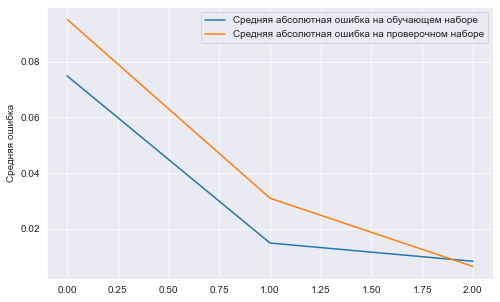

In [90]:
plt.figure(figsize=(8,5))
plt.plot(history.history['loss'][0:], 
         label='Средняя абсолютная ошибка на обучающем наборе')
plt.plot(history.history['val_loss'][0:], 
         label='Средняя абсолютная ошибка на проверочном наборе')
plt.ylabel('Средняя ошибка')
plt.legend()
plt.show()

In [41]:
modelAutoMnist.save_weights('/Users/ekaterina/Desktop/LEARN/IT/УИИ/Введение в нейронные сети/9_modelAutoMnist.h5') 
modelAutoMnist.load_weights('/Users/ekaterina/Desktop/LEARN/IT/УИИ/Введение в нейронные сети/9_modelAutoMnist.h5') 

In [42]:
predMnistTest = modelAutoMnist.predict(xTestMnist) 
predMnistTest = predMnistTest * 255 # представляем в виде значений от 0 до 255
predMnistTest = predMnistTest.astype('uint8') # устанавливаем 8битовый тип

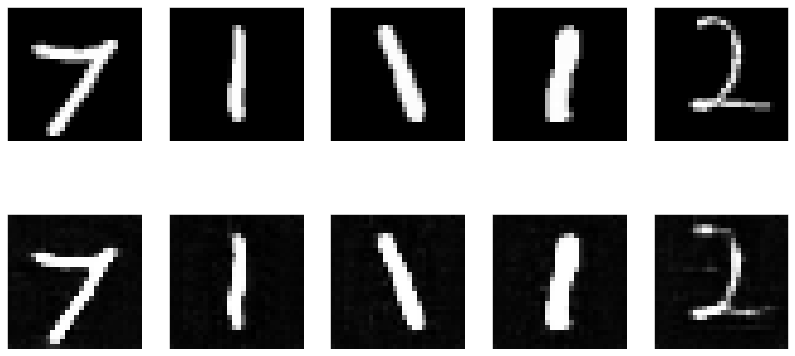

In [43]:
plotImages(xTestMnist, predMnistTest, shape=(28,28)) # покажем исходные и восстановленные картинки

In [44]:
predMnistTrain = modelAutoMnist.predict(xTrainMnist)
predMnistTrain = predMnistTrain * 255 
predMnistTrain = predMnistTrain.astype('uint8') 

In [45]:
# Возьмем среднеквадратичную ошибку от правильной картинки и восстановленной (обучающая выборка)
err1 = [getMSE(xTrainMnist[i], predMnistTrain[i] / 255) for i in range(len(predMnistTrain))]
# (тестовая выборка)
err2 = [getMSE(xTestMnist[i], predMnistTest[i] / 255) for i in range(len(predMnistTest))]
print("Средняя ошибка на обучающем наборе MNIST:", sum(err1) / xTrainMnist.shape[0]) 
print("Средняя ошибка на тестовом наборе MNIST:", sum(err2) /xTestMnist.shape[0] ) 

Средняя ошибка на обучающем наборе MNIST: 0.006435672393189312
Средняя ошибка на тестовом наборе MNIST: 0.006292827478369039


#### Fashion_mnist



In [82]:
# fashion_mnist - базa с одеждой,обувью и т.п
(xTrainMnistF, yTrainMnistF), (xTestMnistF, yTestMnistF) = fashion_mnist.load_data()
xTrainMnistF = xTrainMnistF.astype('float32')/255 # представляем в виде значений от 0 до 1
xTrainMnistF = xTrainMnistF.reshape(xTrainMnistF.shape[0], 28, 28, 1) # приводим к нужным размерам

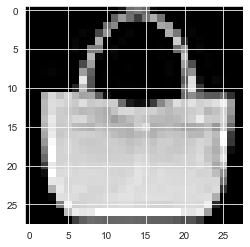

In [83]:
n = 100 # выбираем картинку
plt.imshow(xTrainMnistF[n].reshape((28,28)), cmap='gray') # переводим в 4х-канальное цветовое пространство RGBA
plt.show() 

In [84]:
predMnistF = modelAutoMnist.predict(xTrainMnistF) # для первых ста картинок из fashion_mnist
predMnistF = predMnistF * 255 # представляем в виде значений от 0 до 255
predMnistF = predMnistF.astype('uint8') # устанавливаем 8битовый тип

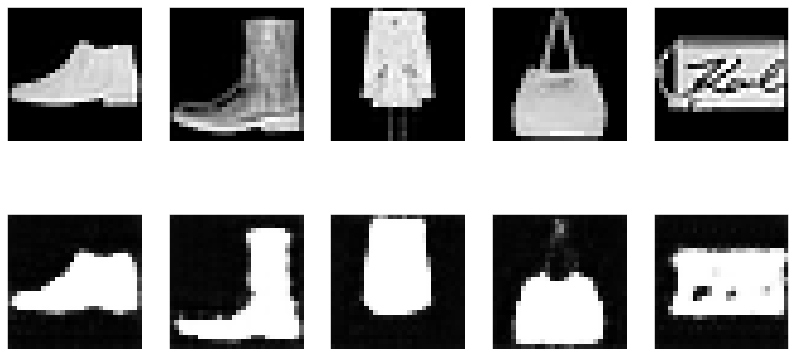

In [85]:
plotImages(xTrainMnistF, predMnistF, shape=(28,28)) #картинки правильных и восстановленных изображений 

In [86]:
errF = [getMSE(xTrainMnistF[i], predMnistF[i] / 255) for i in range(len(predMnistF))]
print("Средняя ошибка на Mnist:", round(sum(err1) / len(err1), 4))
print("Средняя ошибка на одежде:", round(sum(errF) / len(errF), 4))
print()
print("Максимальная ошибка на Mnist:", round(max(err1),4))
print("Минимальная ошибка на одежде:", round(min(errF),4))

Средняя ошибка на Mnist: 0.0067
Средняя ошибка на одежде: 0.0413

Максимальная ошибка на Mnist: 0.0274
Минимальная ошибка на одежде: 0.0026


In [87]:
bias = 0.0012 # установим какое-то пороговое значение
isMnist = [e < bias for e in err1] # запишем каждую ошибку больше порогового значения, Mnist
isMnistF = [e < bias for e in errF] # запишем каждую ошибку больше порогового значения, fashion_mnist

print("Mnist распознано, как Mnist: ", round(100*sum(isMnist) / len(isMnist), 2),"%", sep="")
print("Одежды распознано, как Mnist: ", round(100*sum(isMnistF) / len(isMnistF), 2),"%", sep="")
print("Суммарная ошибка: ", round(100*(1-(sum(isMnist) / len(isMnist)) + sum(isMnistF) / len(isMnistF))),"%", sep="")

Mnist распознано, как Mnist: 0.0%
Одежды распознано, как Mnist: 0.0%
Суммарная ошибка: 100%


#### Визуализация

In [91]:
def create_dense_ae(latent_dim): # объявляем функцию создания автокодировщика
    # Энкодер
    # Входной плейсхолдер
    input_img = Input(shape=(28, 28, 1)) # 28, 28, 1 - размерности строк, столбцов, фильтров одной картинки, без батч-размерности
    # Вспомогательный слой решейпинга
    flat_img = Flatten()(input_img)    
    # Кодированное полносвязным слоем представление
    encoded = Dense(latent_dim, activation='relu')(flat_img)    
    # Декодер
    # Раскодированное другим полносвязным слоем изображение
    input_encoded = Input(shape=(latent_dim,)) # задаем входную размерность (49,)
    flat_decoded = Dense(28*28, activation='sigmoid')(input_encoded) # далее полносвязный слой на 784 нейрона
    decoded = Reshape((28, 28, 1))(flat_decoded) # меняем форму, приводим к нужным нам размерам
    # Модели, в конструктор первым аргументом передаются входные слои, а вторым выходные слои
    # Другие модели можно так же использовать как и слои
    encoder = Model(input_img, encoded, name="encoder")    
    decoder = Model(input_encoded, decoded, name="decoder")    
    # Построим модель автокодировщика (внутри двойное преобразование - сжатие/разжатие)
    autoencoder = Model(input_img, decoder(encoder(input_img)), name="autoencoder")
    return encoder, decoder, autoencoder # функция вернет 3 собранные сетки

In [92]:
def on_epoch_end_AE(epoch, logs):
  print('________________________')  
  print('*** ЭПОХА:', epoch+1,'***')
  print('________________________')  
  plt.figure(figsize=(12,12))
  predict = encoder.predict(new_x_train)
  scatter = plt.scatter(predict[:,0,],predict[:,1], c=new_y_train, alpha=0.6)
  legend2 = plt.legend(*scatter.legend_elements(),loc="upper right", title="Классы")
  #plt.axis('off')
  plt.savefig('image'+str(epoch)+'.jpg')
  plt.show()
  print('loss: ', logs['loss'])

pltAE = LambdaCallback(on_epoch_end=on_epoch_end_AE)

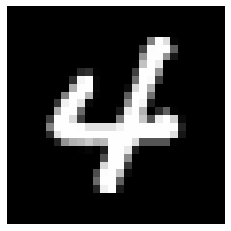

In [93]:
test_img = xTestMnist[np.random.randint(len(xTestMnist))] #случайное изображение из тестовой выборки
plt.imshow(test_img.reshape(28,28), cmap='gray') 
plt.axis('off') # Отклюачем подписи осей
plt.show()

In [95]:
encoder, decoder, autoencoder = create_dense_ae(2) # создаем три сетки с помощью заданной ранее функции

[[0.22268823 0.07354064]]


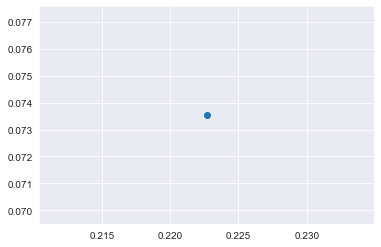

In [96]:
koord = encoder.predict(test_img[None,...]) # Подаем изображение в декодер и получаем предикт (две координаты)
print(koord) 
scatter = plt.scatter(koord[0,0,],koord[0,1]) # Рисуем точку на плоскости
plt.show()

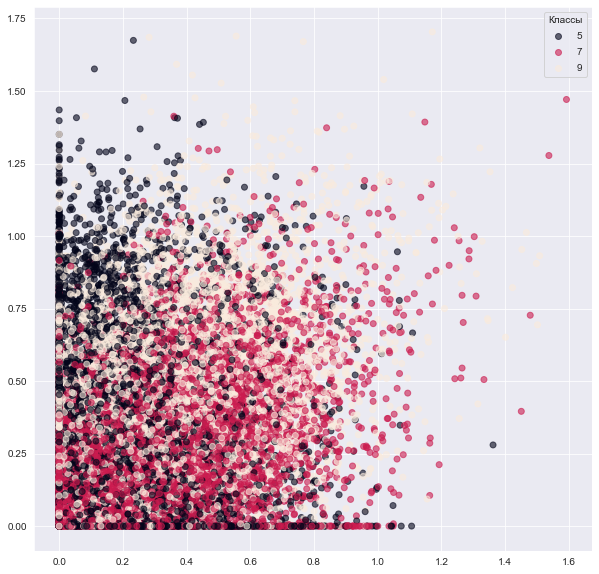

In [97]:
numbers = [5, 7, 9] # Задаем цифры для визуализации
mask = np.array([(i in numbers) for i in yTrainMnist]) # Создаем маску по выбранным цифрам
new_x_train = xTrainMnist[mask] # Выбираем из xTrain только картики по маске
new_y_train = yTrainMnist[mask] # Выбираем из yTrain только метки по маске
plt.figure(figsize=(10,10)) 
predict = encoder.predict(new_x_train) # Получаем предсказание энкодера
scatter = plt.scatter(predict[:,0,],predict[:,1], c=new_y_train, alpha=0.6) # Выводим точки для всех изображений
legend2 = plt.legend(*scatter.legend_elements(),loc="upper right", title="Классы") # Выводим легенду
plt.show()

________________________
*** ЭПОХА: 1 ***
________________________


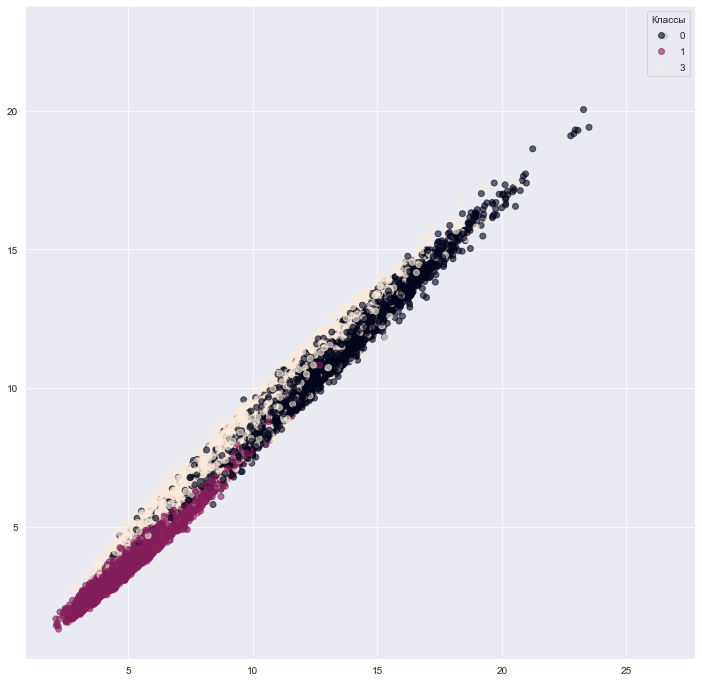

loss:  0.5889895558357239
________________________
*** ЭПОХА: 2 ***
________________________


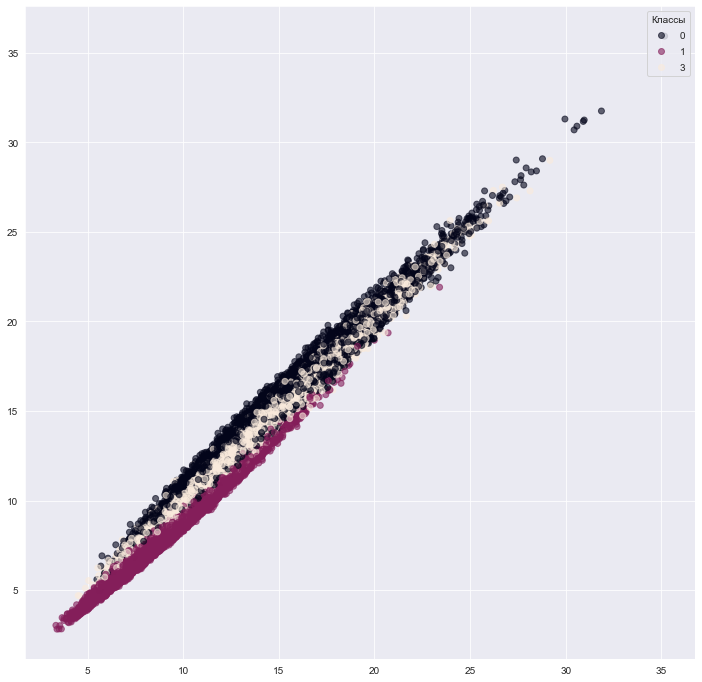

loss:  0.33187031745910645
________________________
*** ЭПОХА: 3 ***
________________________


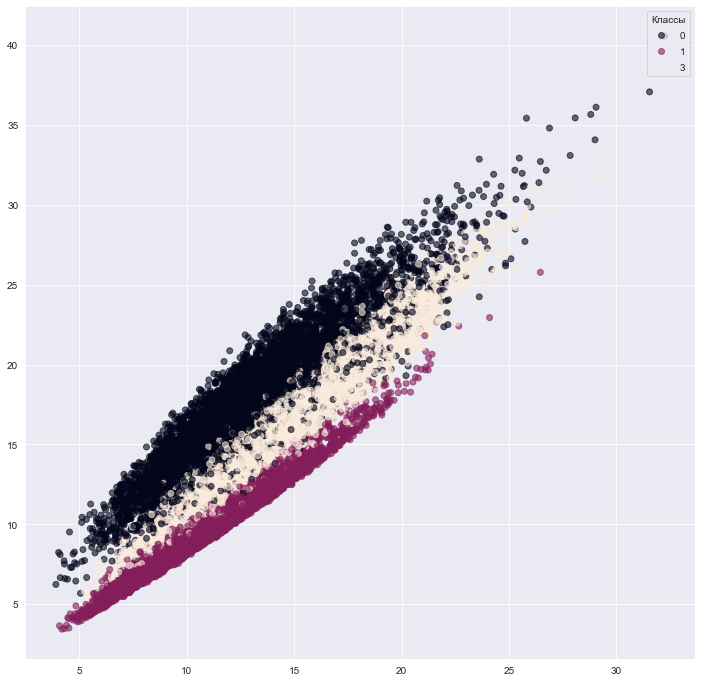

loss:  0.28204187750816345
________________________
*** ЭПОХА: 4 ***
________________________


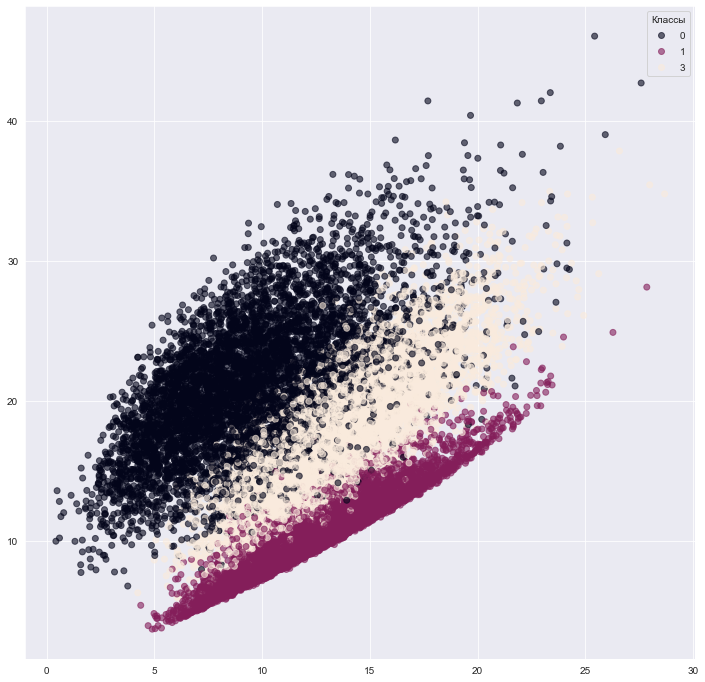

loss:  0.25897884368896484
________________________
*** ЭПОХА: 5 ***
________________________


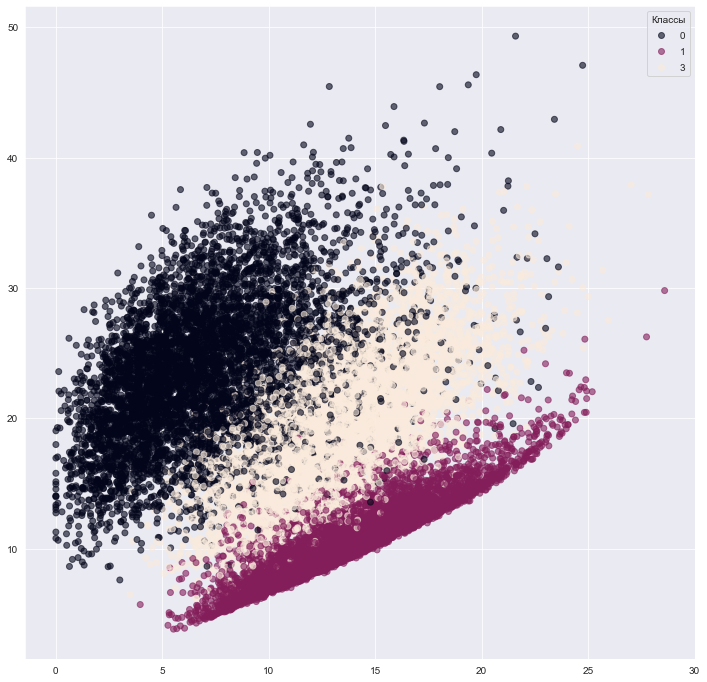

loss:  0.23623351752758026
________________________
*** ЭПОХА: 6 ***
________________________


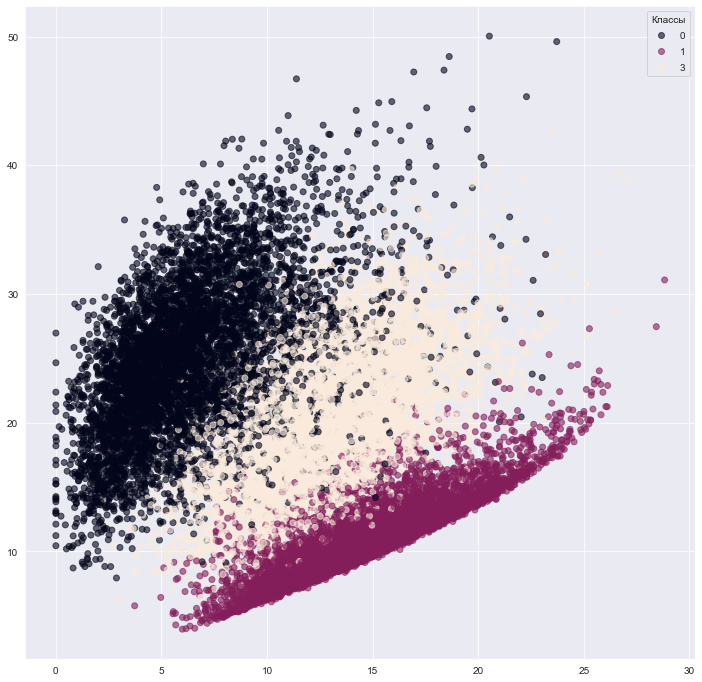

loss:  0.22528760135173798
________________________
*** ЭПОХА: 7 ***
________________________


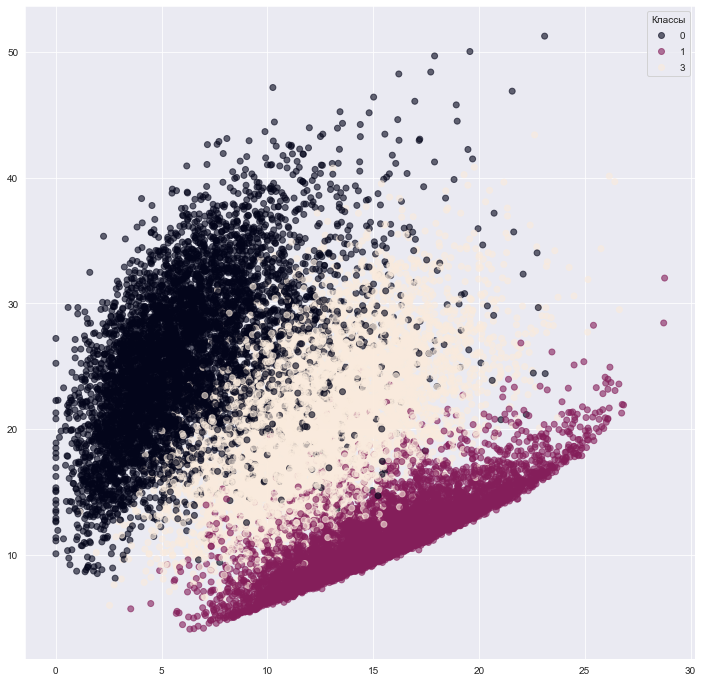

loss:  0.22048421204090118
________________________
*** ЭПОХА: 8 ***
________________________


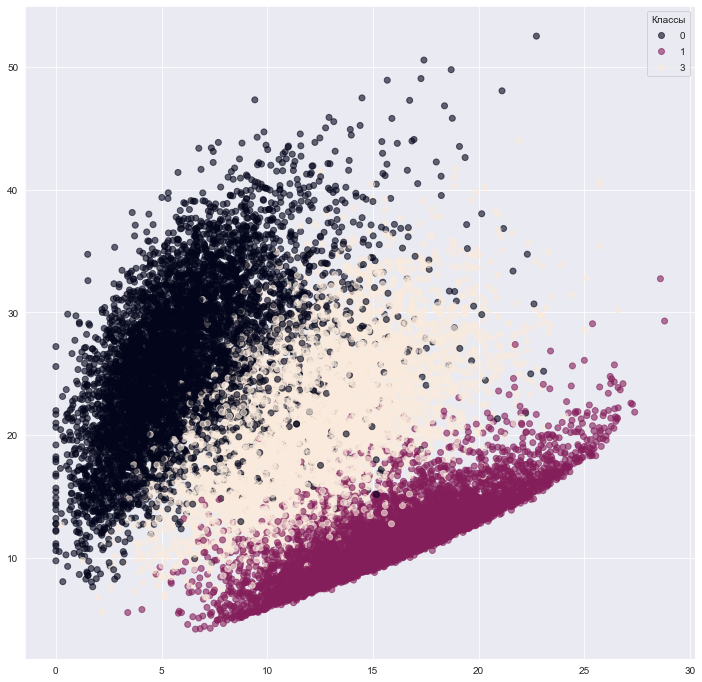

loss:  0.21769660711288452
________________________
*** ЭПОХА: 9 ***
________________________


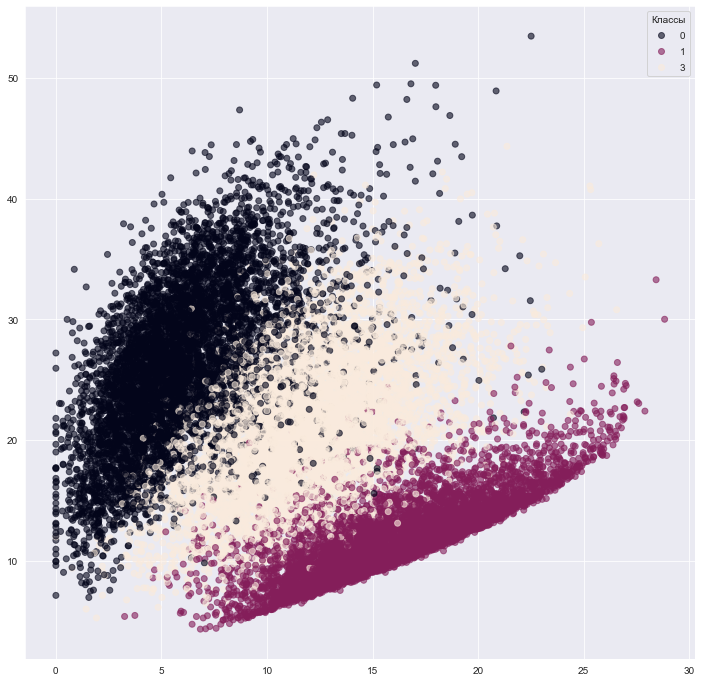

loss:  0.21574586629867554
________________________
*** ЭПОХА: 10 ***
________________________


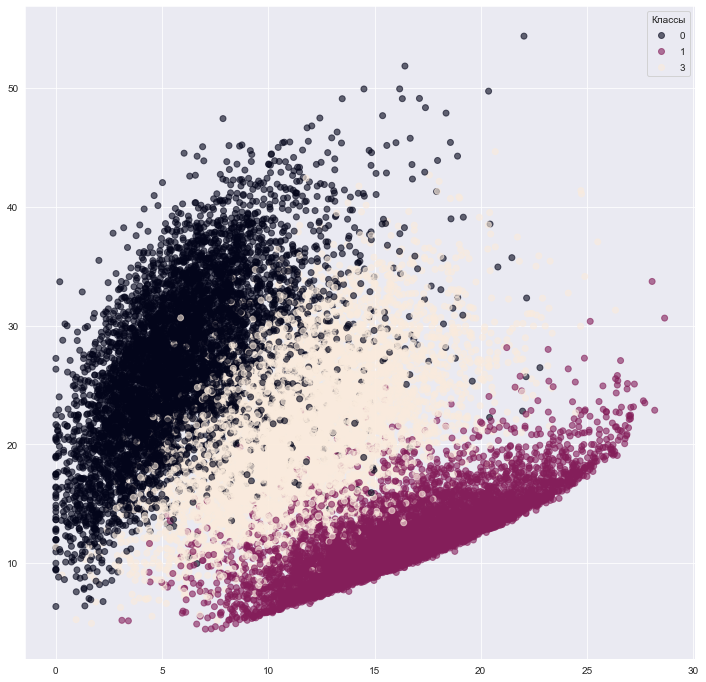

loss:  0.21424604952335358
________________________
*** ЭПОХА: 11 ***
________________________


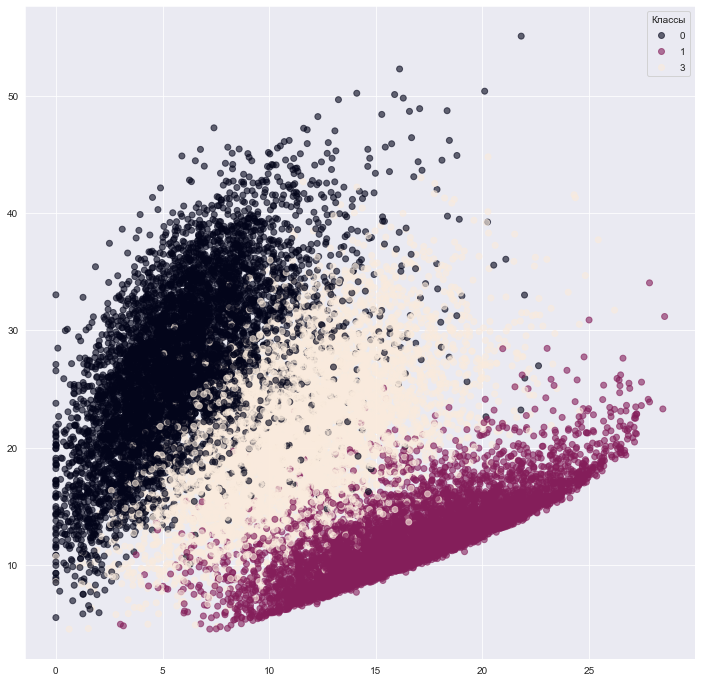

loss:  0.21302910149097443
________________________
*** ЭПОХА: 12 ***
________________________


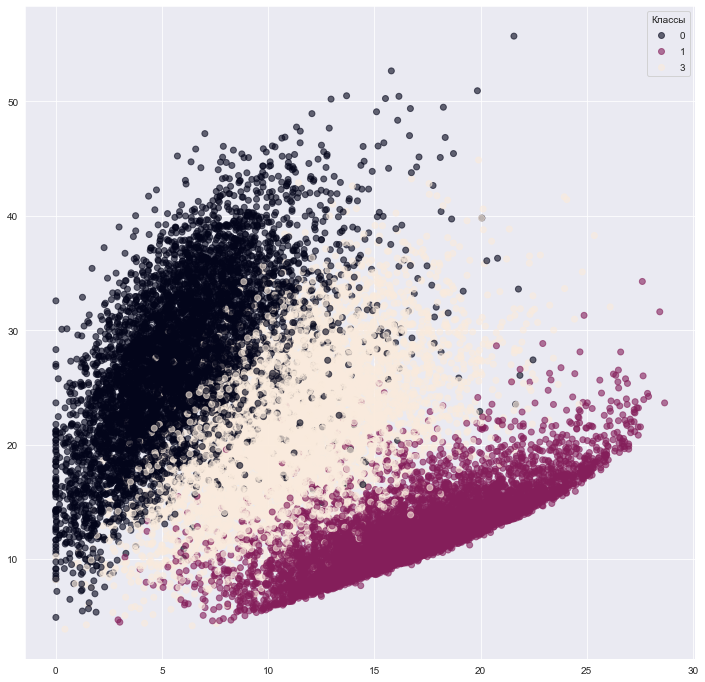

loss:  0.21198409795761108
________________________
*** ЭПОХА: 13 ***
________________________


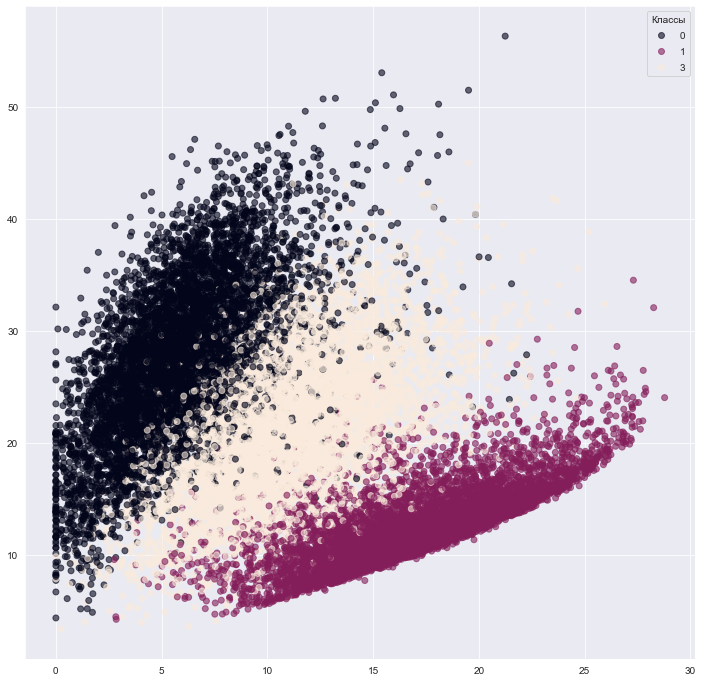

loss:  0.21107906103134155
________________________
*** ЭПОХА: 14 ***
________________________


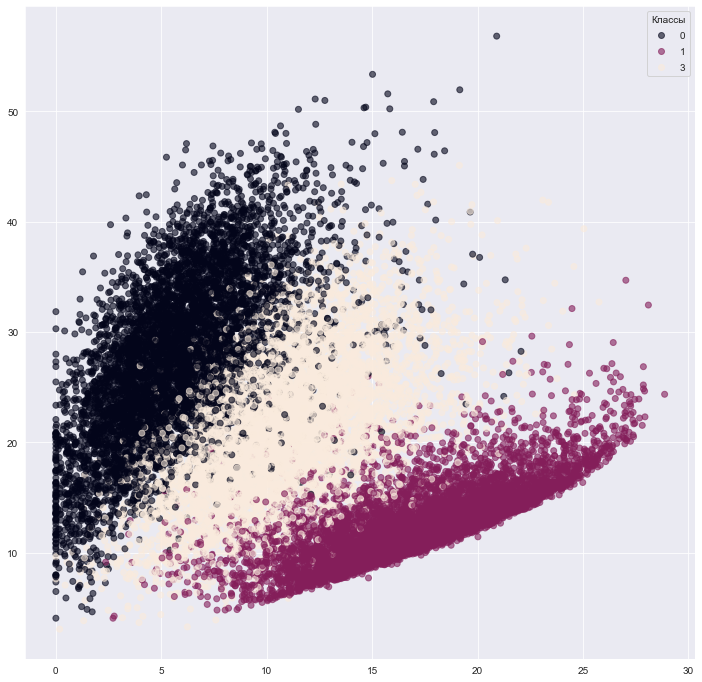

loss:  0.21028093993663788
________________________
*** ЭПОХА: 15 ***
________________________


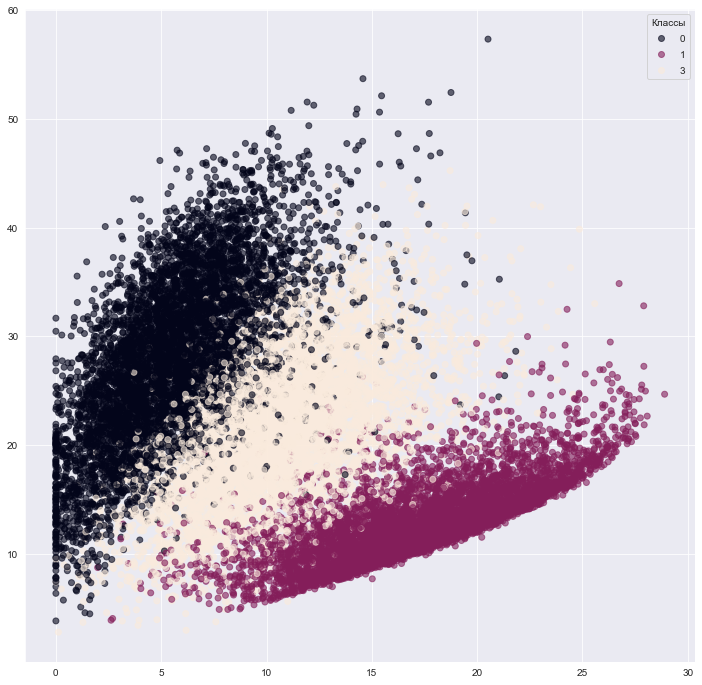

loss:  0.2095617800951004
________________________
*** ЭПОХА: 16 ***
________________________


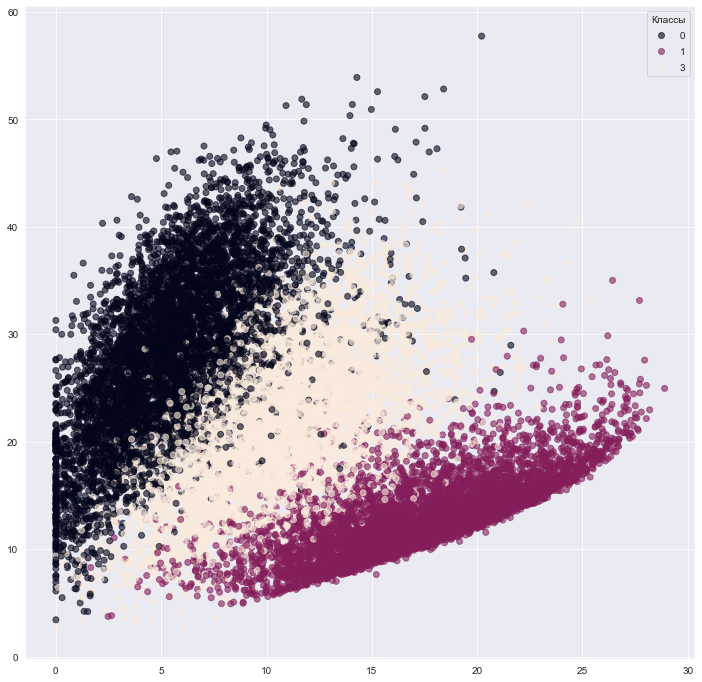

loss:  0.20888756215572357
________________________
*** ЭПОХА: 17 ***
________________________


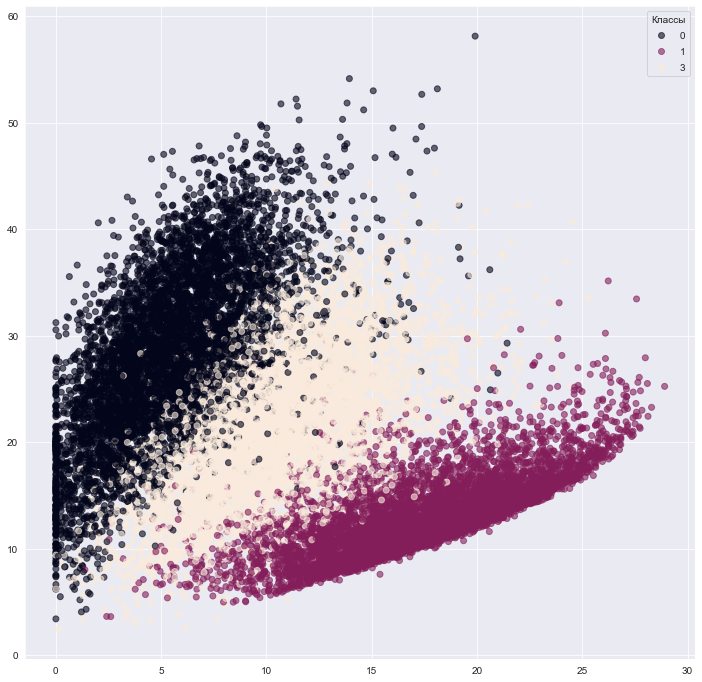

loss:  0.2082832306623459
________________________
*** ЭПОХА: 18 ***
________________________


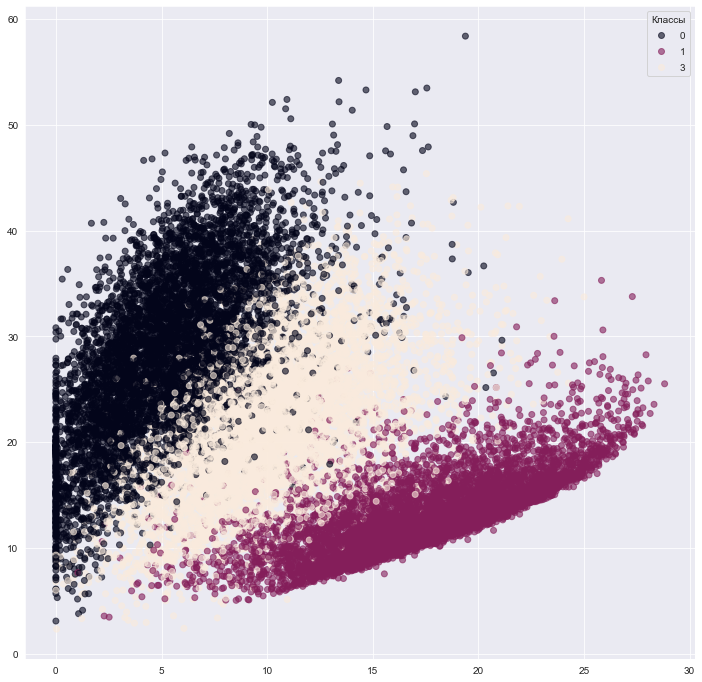

loss:  0.2077186554670334
________________________
*** ЭПОХА: 19 ***
________________________


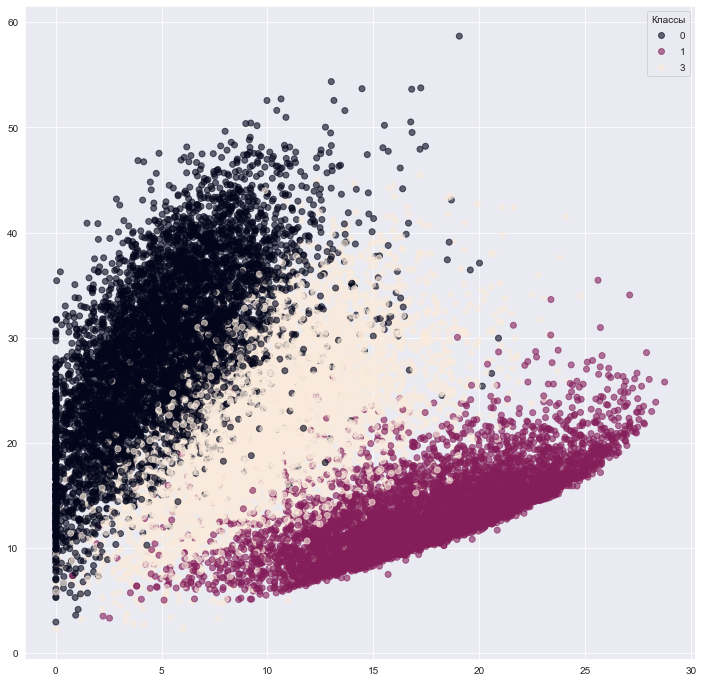

loss:  0.20717497169971466
________________________
*** ЭПОХА: 20 ***
________________________


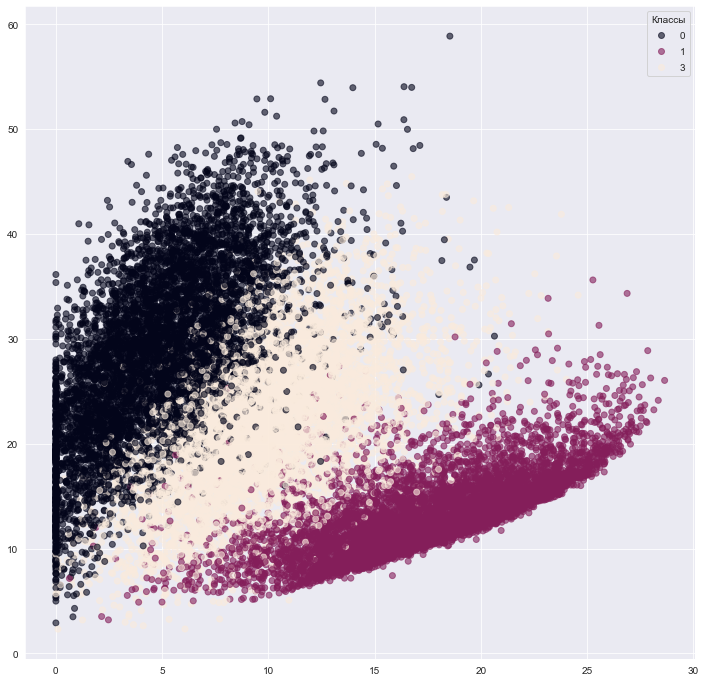

loss:  0.20666077733039856


In [98]:
# компилируем модель с выбранным оптимайзером и функцией потерь
autoencoder.compile(optimizer='adam', loss='binary_crossentropy')  
classes = [0, 1, 3]
EPOCHS = 20
mask = np.array([(i in classes) for i in yTrainMnist])
new_x_train = xTrainMnist[mask]
new_y_train = yTrainMnist[mask]
autoencoder.fit(new_x_train, new_x_train,
                epochs=EPOCHS,
                batch_size=256,
                shuffle=True,
                callbacks = [pltAE],
                verbose=0)

In [99]:
koord = np.array([[17, 12]]) # Возьмем точку с указанными координатами
result = decoder.predict(koord) # Используя обученный декодер, попробуем восстановить исходное изображение
print(result.shape) # Выведем размер полученного тензора

(1, 28, 28, 1)


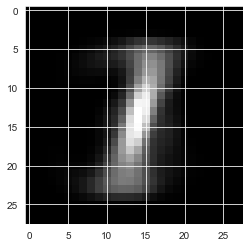

In [100]:
plt.imshow(result[0].reshape(28,28), cmap='gray') 
plt.show()

In [101]:
import imageio 
images = [] # список под изображения для gif
for i in range(30): 
    images.append(imageio.imread('image'+str(i)+'.jpg')) # Добавляем в список изображение очередную картинку
imageio.mimsave('AE.gif', images) # С помощью метода .mimsave() сохраняем анимацию

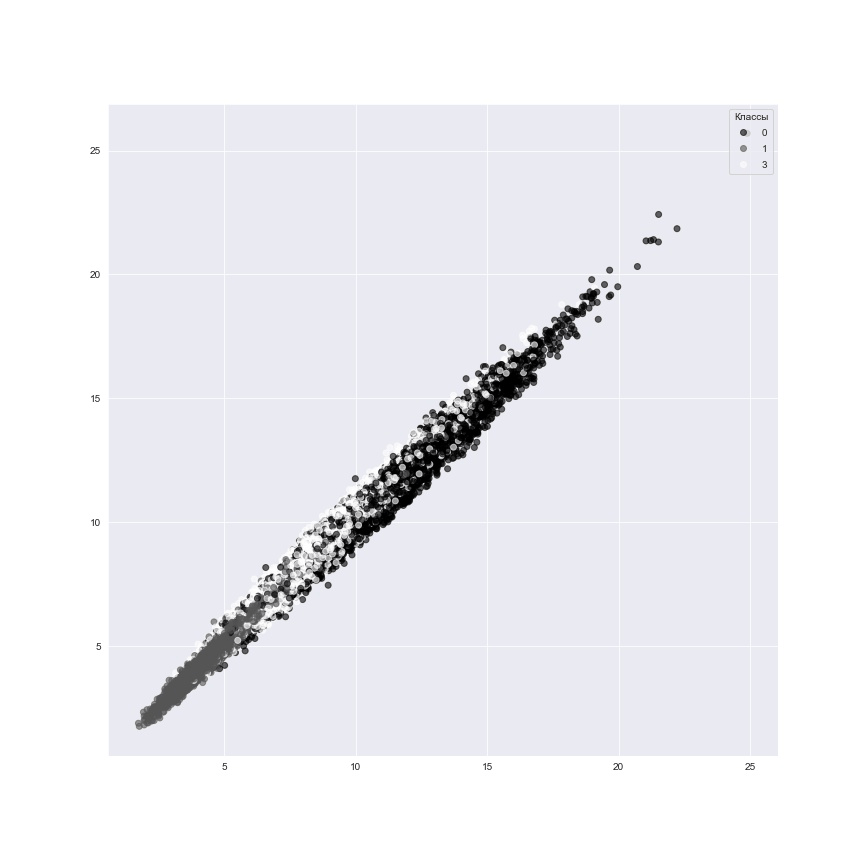

In [102]:
from IPython.display import Image 
Image(open('AE.gif','rb').read()) # Визуализируем анимацию

#### Определение мошеннических операций


In [11]:
df = pd.read_csv("/Users/ekaterina/Desktop/LEARN/IT/УИИ/Введение в нейронные сети/9_creditcard.csv")

In [12]:
df.head(2) 

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,0.0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,...,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,149.62,0
1,0.0,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,...,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,2.69,0


In [13]:
# Удаляем столбец со временем
data = df.drop(['Time'], axis=1)
# Нормализуем столбец с суммой транзакции
data['Amount'] = StandardScaler().fit_transform(data['Amount'].values.reshape(-1, 1))

frauds = data[data.Class == 1] # записываем мошеннические операции
normal = data[data.Class == 0] # записываем нормальные операции

In [14]:
frauds.shape 

(492, 30)

In [15]:
normal.shape 

(284315, 30)

In [16]:
RANDOM_SEED = 42 
X_train, X_test = train_test_split(normal, test_size=0.2, random_state=RANDOM_SEED)

In [17]:
# Удаляем класс в обучающем наборе данных
X_train = X_train.drop(['Class'], axis=1)
# Добавляем все мошеннические транзакции в тестовый набор данных
X_test = pd.concat([X_test, frauds])
# Делаем метки для тестового набора данных
y_test = X_test['Class']
# Удаляем класс у тестового набора данных
X_test = X_test.drop(['Class'], axis=1)
# Преобразуем данные в массивы numpy
X_train = X_train.values
X_test = X_test.values

In [18]:
print(X_train.shape)

(227452, 29)


In [19]:
def creditcardAutoencoder(): # объявляем автокодировщик для определения мошенич.транзакций
  dataSize = X_train.shape[1] # берём размеры X_train по второй оси(30)
  dataInput = Input(shape=(dataSize, )) # задаем эти размеры как входные в сеть
  
  x = Dense(10, activation='relu')(dataInput) # пропускаем через полносвязный слой размером 10
  x = Dense(dataSize, activation='linear')(x) # и через полносвязный слой размером 29 
  
  autoencoder = Model(inputs=dataInput, outputs=x) # собрали модель 
  
  autoencoder.compile(optimizer='Adam', loss='mse') # компилируем модель также, с выбором оптимайзера и среднеквадратичной ошибки
  
  return autoencoder 

In [20]:
model = creditcardAutoencoder()

In [21]:
history = model.fit(X_train, X_train,
                    epochs=10,
                    batch_size=32) # загружаем данные в модель(X_train'ы) и обучаем

Epoch 1/10
7108/7108 [==============================] - 14s 2ms/step - loss: 0.4424
Epoch 2/10
7108/7108 [==============================] - 12s 2ms/step - loss: 0.3583
Epoch 3/10
7108/7108 [==============================] - 12s 2ms/step - loss: 0.3554
Epoch 4/10
7108/7108 [==============================] - 12s 2ms/step - loss: 0.3548
Epoch 5/10
7108/7108 [==============================] - 12s 2ms/step - loss: 0.3546
Epoch 6/10
7108/7108 [==============================] - 12s 2ms/step - loss: 0.3545
Epoch 7/10
7108/7108 [==============================] - 11s 2ms/step - loss: 0.3545
Epoch 8/10
7108/7108 [==============================] - 12s 2ms/step - loss: 0.3544
Epoch 9/10
7108/7108 [==============================] - 12s 2ms/step - loss: 0.3543
Epoch 10/10
7108/7108 [==============================] - 13s 2ms/step - loss: 0.3543


In [22]:
model.save_weights('/Users/ekaterina/Desktop/LEARN/IT/УИИ/Введение в нейронные сети/9_modelCredit.h5')
model.load_weights('/Users/ekaterina/Desktop/LEARN/IT/УИИ/Введение в нейронные сети/9_modelCredit.h5')

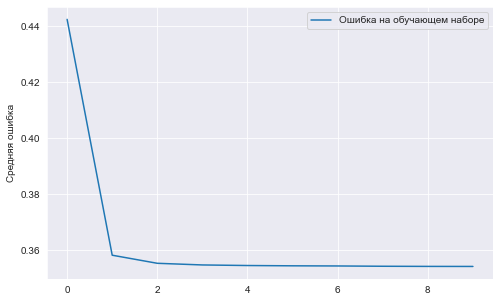

In [23]:
plt.figure(figsize=(8,5))
plt.plot(history.history['loss'][0:], 
         label='Ошибка на обучающем наборе')
plt.ylabel('Средняя ошибка')
plt.legend()
plt.show()

In [24]:
predictions = model.predict(X_test) 

In [25]:
mse = np.mean(np.power(X_test - predictions, 2), axis=1)

In [26]:
mse_normal = mse[y_test.values == 0] 
mse_frauds = mse[y_test.values == 1] 

In [27]:
print("Минимальная ошибка нормальных транзакций:", round(min(mse_normal),4)) 
print("Максимальная ошибка нормальных транзакций:", round(max(mse_normal),4)) 
print("Средняя ошибка нормальных транзакций:", round(sum(mse_normal) / len(mse_normal),4)) 

Минимальная ошибка нормальных транзакций: 0.0399
Максимальная ошибка нормальных транзакций: 344.9751
Средняя ошибка нормальных транзакций: 0.3551


In [28]:
print("Минимальная ошибка мошеннических транзакций:", round(min(mse_frauds),4)) 
print("Максимальная ошибка мошеннических транзакций:", round(max(mse_frauds),4)) 
print("Средняя ошибка мошеннических транзакций:", round(sum(mse_frauds) / len(mse_frauds),4)) 

Минимальная ошибка мошеннических транзакций: 0.1581
Максимальная ошибка мошеннических транзакций: 102.0004
Средняя ошибка мошеннических транзакций: 18.9065


In [29]:
def getAccByBias(bias): # функция будет принимать какое то пороговое значение
  isNormal = mse_normal < bias # если ошибка меньше порога - то транзакция нормальная
  isFrauds = mse_frauds > bias # если ошибка больше порога - то транзакция мошенническая

  accNormal = sum(isNormal) / len(isNormal) # вычисляем процент нормальных операций
  accFaruds = sum(isFrauds) / len(isFrauds) # вычисляем процент мошеннических операций

  print("Распознано нормальных транзакций: ", round(100*accNormal), "%", sep="")
  print("Распознано мошеннических транзакций: ", round(100*accFaruds), "%", sep="")
  print("Средняя точность распознавания: ", round(50*(accNormal + accFaruds)), "%", sep="")

In [30]:
getAccByBias(0.65) # выведем данные по распознаванию с конкретным пороговым значением

Распознано нормальных транзакций: 93%
Распознано мошеннических транзакций: 90%
Средняя точность распознавания: 92%


#### Лица

In [48]:
path = '/Users/ekaterina/Desktop/LEARN/IT/УИИ/Введение в нейронные сети/9_facez'
for el in os.walk(path):
    print(el)

('/Users/ekaterina/Desktop/LEARN/IT/УИИ/Введение в нейронные сети/9_facez', [], ['63.jpg', '823.jpg', '4217.jpg', '3578.jpg', '2666.jpg', '2100.jpg', '4571.jpg', '1409.jpg', '189.jpg', '2114.jpg', '4565.jpg', '4203.jpg', '2672.jpg', '77.jpg', '837.jpg', '2882.jpg', '3544.jpg', '1353.jpg', '1435.jpg', '3222.jpg', '2128.jpg', '3236.jpg', '4559.jpg', '1421.jpg', '1347.jpg', '2896.jpg', '3550.jpg', '638.jpg', '2869.jpg', '1390.jpg', '604.jpg', '2699.jpg', '2841.jpg', '3587.jpg', '162.jpg', '176.jpg', '2855.jpg', '3593.jpg', '88.jpg', '610.jpg', '1384.jpg', '4773.jpg', '2302.jpg', '2464.jpg', '4015.jpg', '1179.jpg', '2470.jpg', '4001.jpg', '4767.jpg', '3008.jpg', '2316.jpg', '3020.jpg', '4997.jpg', '1637.jpg', '1151.jpg', '2458.jpg', '3746.jpg', '4029.jpg', '3752.jpg', '1145.jpg', '1623.jpg', '3034.jpg', '4983.jpg', '4968.jpg', '1810.jpg', '3961.jpg', '3975.jpg', '1804.jpg', '348.jpg', '360.jpg', '4954.jpg', '3785.jpg', '406.jpg', '1192.jpg', '1186.jpg', '412.jpg', '3791.jpg', '3949.jpg', '

In [ ]:
#!unzip -q '/Users/ekaterina/Desktop/LEARN/IT/УИИ/Введение в нейронные сети/9_facez' # распоковываем базу с лицами с google диска в colaboratory

In [52]:
images_dir = '9_facez' # зададим имя папки в которую распоковали изображения
img_height = 112 # зададим высоту изображений
img_width = 80 # зададим ширину избражений

In [53]:
# функция загрузки изображений, на вход принемает имя папки с изображениями, высоту и ширину к которой будут преобразованы загружаемые изображения
def load_images(images_dir, img_height, img_width): 
  list_images = [] # создаем пустой список в который будем загружать изображения
  for img in os.listdir(images_dir): # получим список изображений и для каждого изображения
  # добавим в список изображение в виде массива, с заданными размерами, в отенках серого
    list_images.append(image.img_to_array(image.load_img(os.path.join(images_dir, img), target_size=(img_height, img_width), color_mode='grayscale')))
  return np.array(list_images) # возвращаем numpy массив загруженных избражений

In [54]:
cur_time = time.time() 
xTrain_imag = load_images(images_dir, img_height, img_width) # загрузим избражения лиц
print ('Время загрузки: ', round(time.time()-cur_time, 2), 'с', sep='')

Время загрузки: 50.27с


In [55]:
xTrain_img = xTrain_imag/255 # отнормируем изображения от 0 до 1

In [56]:
xTrain_img.shape # выведем размерность массива

(5018, 112, 80, 1)

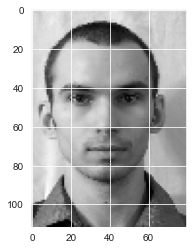

In [57]:
plt.imshow(xTrain_img[np.random.randint(0, xTrain_img.shape[0])].reshape(112,80), cmap='gray') #выведем случайное изображение
plt.show()

In [58]:
modelAutoFace = baseAutoencoder() # создаем автокодировщик

In [59]:
# грузим данные в нашу модель, берём первые 4700 из xTrain_img и на вход, и на выход, в качестве проверочной берем оставшиеся из xTrain_img
modelAutoFace.fit(xTrain_img[:4700], xTrain_img[:4700], epochs=50, batch_size=100, validation_data = (xTrain_img[4700:], xTrain_img[4700:]))

Epoch 1/50
47/47 [==============================] - 591s 12s/step - loss: 0.0448 - val_loss: 0.0693
Epoch 2/50
47/47 [==============================] - 555s 12s/step - loss: 0.0119 - val_loss: 0.0697
Epoch 3/50
47/47 [==============================] - 530s 11s/step - loss: 0.0073 - val_loss: 0.0683
Epoch 4/50
47/47 [==============================] - 332s 7s/step - loss: 0.0058 - val_loss: 0.0651
Epoch 5/50
47/47 [==============================] - 286s 6s/step - loss: 0.0051 - val_loss: 0.0602
Epoch 6/50
47/47 [==============================] - 303s 6s/step - loss: 0.0045 - val_loss: 0.0529
Epoch 7/50
47/47 [==============================] - 405s 9s/step - loss: 0.0043 - val_loss: 0.0442
Epoch 8/50
47/47 [==============================] - 490s 10s/step - loss: 0.0039 - val_loss: 0.0365
Epoch 9/50
47/47 [==============================] - 489s 10s/step - loss: 0.0038 - val_loss: 0.0283
Epoch 10/50
47/47 [==============================] - 434s 9s/step - loss: 0.0036 - val_loss: 0.0196
Epoc

In [60]:
modelAutoFace.save_weights('/Users/ekaterina/Desktop/LEARN/IT/УИИ/Введение в нейронные сети/9_modelAutoFace.h5') # Сохраняем модель
modelAutoFace.load_weights('/Users/ekaterina/Desktop/LEARN/IT/УИИ/Введение в нейронные сети/9_modelAutoFace.h5') # Загружаем модель

In [61]:
predFace = modelAutoFace.predict(xTrain_img[:100]) # Получаем предсказание модели первых 100 лиц из обучающей выборки
predFace = predFace * 255 # представляем в виде значений от 0 до 255
predFace = predFace.astype('uint8') # устанавливаем 8битовый тип

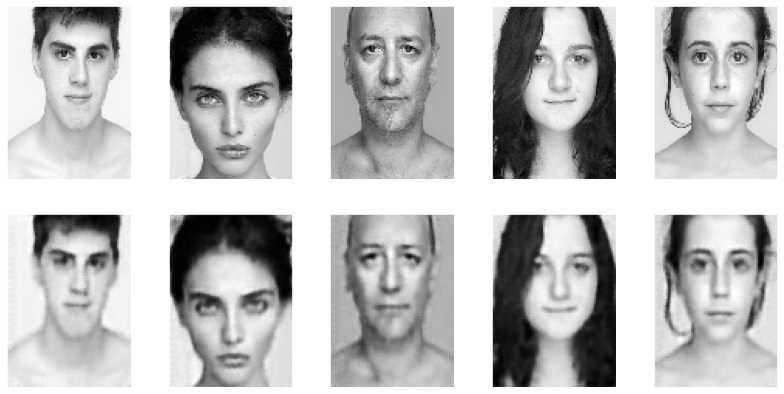

In [62]:
plotImages(xTrain_img, predFace) #выведем оригинальные и сгенерированные автокодировщиком

In [63]:
# Возьмем среднеквадратичные ошибки и выведем их для лиц 
errFace = [getMSE(xTrain_img[i], predFace[i] / 255) for i in range(len(predFace))] # посчитаем ошибку для всех изображений
print("Средняя ошибка на Лицах:", round(sum(errFace[80:]) / len(errFace[80:]), 4)) # посчитаем для последних 20 среднюю ошибку
print("Минимальная ошибка на Лицах:", round(min(errFace),4)) #найдем минимальную ошибку

Средняя ошибка на Лицах: 0.0022
Минимальная ошибка на Лицах: 0.0006


### Генерация из шума


In [64]:
noise = np.random.sample((100,112,80,1)) # создаем 100 картинок шума
print(noise.shape) # выведем размеры

(100, 112, 80, 1)


In [65]:
predNoise = modelAutoFace.predict(noise[:100]) # сделаем предикт этих шумовых картинок
predNoise = predNoise * 255 # представляем в виде значений от 0 до 255
predNoise = predNoise.astype('uint8') # устанавливаем 8битовый тип

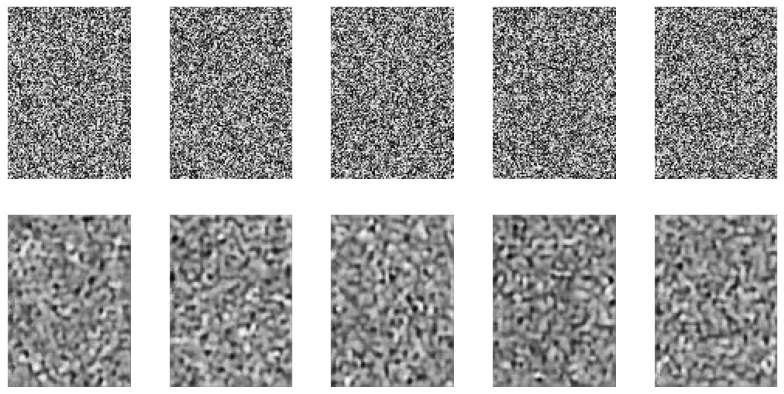

In [66]:
plotImages(noise, predNoise) # выведем на экран исходные шумовые картинки и восстановленые 

In [67]:
# Возьмем среднеквадратичные ошибки и выведем их для Mnist и для шумовых изображений
errN = [getMSE(noise[i], predNoise[i] / 255) for i in range(len(predNoise))]
print("Средняя ошибка на Лицах:", round(sum(errFace) / len(errFace), 4))
print("Средняя ошибка на шуме:", round(sum(errN) / len(errN), 4))
print("Максимальная ошибка на Лицах:", round(max(errFace),4))
print("Минимальная ошибка на шуме:", round(min(errN),4))

Средняя ошибка на Лицах: 0.002
Средняя ошибка на шуме: 0.0748
Максимальная ошибка на Лицах: 0.0096
Минимальная ошибка на шуме: 0.0728


In [68]:
bias = 0.0073 # установим какое-то пороговое значение
isFace = [e < bias for e in errFace] # запишем каждую ошибку больше порогового значения, Mnist
isNoise = [e < bias for e in errN] # запишем каждую ошибку больше порогового значения, fashion_mnist

print("Лиц распознано, как Лиц: ", round(100*sum(isFace) / len(isFace)),"%", sep="")
print("Шума распознано, как Лиц: ", round(100*sum(isNoise) / len(isNoise)),"%", sep="")
print("Суммарная ошибка: ", round(100*(1-(sum(isFace) / len(isFace)) + sum(isNoise) / len(isNoise))),"%", sep="")

Лиц распознано, как Лиц: 99%
Шума распознано, как Лиц: 0%
Суммарная ошибка: 1%


### Удаление шума


In [69]:
def addNoise(x, noiseVal): # объявим функцию добавления шума
  #noise = np.random.sample((x.shape[0],28,28,1))
  noise = np.random.normal(loc=0.5, scale=0.5, size=x.shape) # создаем шум(с центром в 0.5 и отклонением 0.5)
  
  # Cкладываем с произведением шума*на усилитель шума и вводим ограничение значений от 0 до 1(clip)
  return np.clip(x + noiseVal * noise, 0., 1.) 

In [70]:
noisedXTrainFace = addNoise(xTrain_img, 0.05) # cоздаем зашумленный вариант лиц из xTrain_img

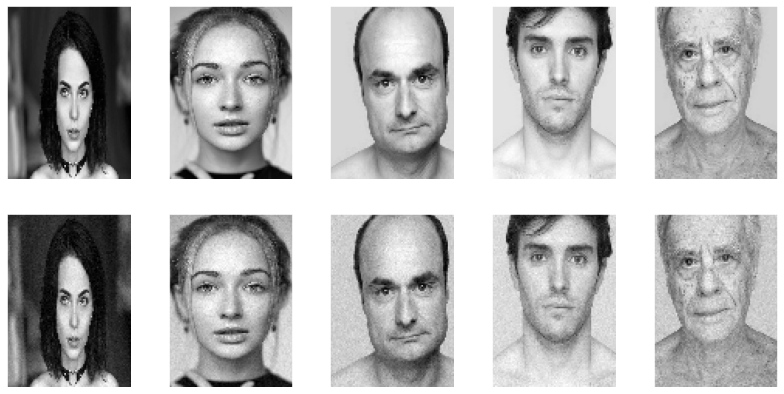

In [71]:
plotImages(xTrain_img, noisedXTrainFace) # выведем на экран исходные лица и зашумленные варианты 

In [72]:
def denoiseAutoencoder(): # объявляем функцию создания автокодировщика для подавления шума
    img_input = Input((112,80,1)) # задаём входные размеры

    # Добавляем четыре сверточных слоя, вместо MaxPooling используем strides
    x = Conv2D(32, (3, 3), strides=2, activation='relu', padding='same')(img_input)
    x = Conv2D(64, (3, 3), strides=2, activation='relu', padding='same')(x)
    x = Conv2D(128, (3, 3), strides=2, activation='relu', padding='same')(x)
    x = Conv2D(256, (3, 3), strides=2, activation='relu', padding='same')(x)
    x = Flatten()(x) # сплющиваем в одномерный вектор - размер 7*5*256
    z = Dense(256, activation='relu')(x) # добавляем полносвязный слой
    x = Dense(7*5*256, activation='relu')(z) # и еще полносвязный слой с переводом в 8960-мерное пространство(7*5*256)
    x = Reshape((7,5,256))(x) # меняем размеры - картинка 7*5 , 256 ядер
    x = Conv2DTranspose(256, (3, 3), strides=2, padding='same')(x) # разжимаем картинки из 7*5 до 14*10
    x = Conv2DTranspose(128, (3, 3), strides=2, padding='same')(x) # разжимаем картинки из 14*10 до 28*20
    x = Conv2DTranspose(64, (3, 3), strides=2, padding='same')(x) # разжимаем картинки из 28*20 до 56*40
    x = Conv2DTranspose(32, (3, 3), strides=2, padding='same')(x) # разжимаем картинки из 56*40 до 112*80
    x = Conv2D(1, (3, 3), activation='sigmoid', padding='same')(x) # и пропускаем через финальный слой двумерной свертки

    model = Model(img_input, x) # собрали модель с зашумленной картинкой на вход и с очищенной от шума на выход
    model.compile(optimizer='adam',
                  loss='mse') # компилируем модель также, с выбором оптимайзера и среднеквадратичной ошибки

    return model # функция вернет модель подавления шума

In [73]:
modelDenoiseFace = denoiseAutoencoder()

In [75]:
# Подаем на вход зашумленные картинки, а на выход правильные, исходные картинки, и обучаем
modelDenoiseFace.fit(noisedXTrainFace[:4700], xTrain_img[:4700], epochs=30, batch_size=100, validation_data = (noisedXTrainFace[4700:], xTrain_img[4700:]))

Epoch 1/30
47/47 [==============================] - 84s 2s/step - loss: 0.0529 - val_loss: 0.0352
Epoch 2/30
47/47 [==============================] - 65s 1s/step - loss: 0.0236 - val_loss: 0.0186
Epoch 3/30
47/47 [==============================] - 68s 1s/step - loss: 0.0158 - val_loss: 0.0138
Epoch 4/30
47/47 [==============================] - 68s 1s/step - loss: 0.0126 - val_loss: 0.0119
Epoch 5/30
47/47 [==============================] - 78s 2s/step - loss: 0.0112 - val_loss: 0.0111
Epoch 6/30
47/47 [==============================] - 80s 2s/step - loss: 0.0103 - val_loss: 0.0102
Epoch 7/30
47/47 [==============================] - 66s 1s/step - loss: 0.0094 - val_loss: 0.0093
Epoch 8/30
47/47 [==============================] - 86s 2s/step - loss: 0.0089 - val_loss: 0.0090
Epoch 9/30
47/47 [==============================] - 76s 2s/step - loss: 0.0084 - val_loss: 0.0086
Epoch 10/30
47/47 [==============================] - 79s 2s/step - loss: 0.0081 - val_loss: 0.0088
Epoch 11/30
47/47 [

In [76]:
modelDenoiseFace.save_weights('/Users/ekaterina/Desktop/LEARN/IT/УИИ/Введение в нейронные сети/9_modelDenoiseFace.h5') # Сохраняем модель
modelDenoiseFace.load_weights('/Users/ekaterina/Desktop/LEARN/IT/УИИ/Введение в нейронные сети/9_modelDenoiseFace.h5') # Сохраняем модель

In [77]:
predFaceDenoise = modelDenoiseFace.predict(noisedXTrainFace[:4000]) # подаем 4тыс зашумленных картинок и делаем предикт
predFaceDenoise = predFaceDenoise * 255 # представляем в виде значений от 0 до 255
predFaceDenoise = predFaceDenoise.astype('uint8') # устанавливаем 8битовый тип

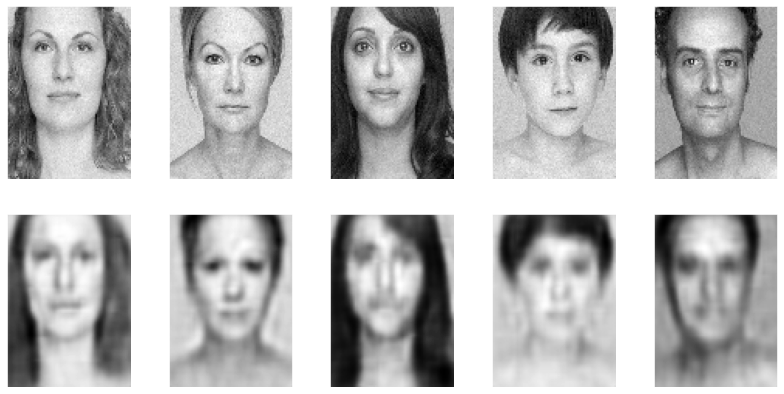

In [78]:
plotImages(noisedXTrainFace, predFaceDenoise) # взглянем как отрабатывает шумоподавление на зашумленных картинках

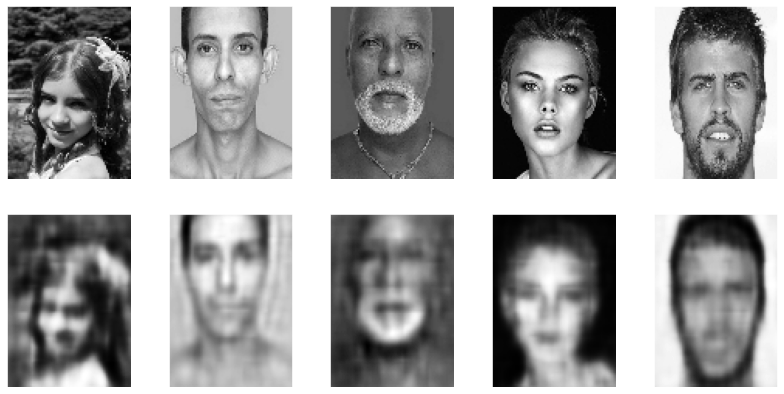

In [79]:
plotImages(xTrain_img, predFaceDenoise) # взглянем как отрабатывает шумоподавление на лицах